# Introduction/Business Problem

Our goal here is to identify similar neighborhoods across 2 different cities New York and Toronto, based on the most popular venue categories of the neighborhood. 

We will utilize the Foursquare Location API, to find out the popular venue categories for each of the neighborhoods of New York and Toronto.

This is useful for people, who are likely to move on from New York to Toronto or Toronto to New York, and are looking for to move to a neighbourhood with the similar characteristics (the same popular venue categories) as the one they are currently living in.

# Data

Foursquare is a location data provider. We need to create a foursquare developer account and get the credentials to extract the data. The Foursqure website link to create the account is: https://developer.foursquare.com/ . The data can be extracted using the API or the foursquare python package.  

Using foursquare data, we can search for nearby venues of a specific type, explore a particular venue, and search for trending venues around a location and many more. To find the most popular venue categories, we will be using the explore endpoint of the Foursquare API.  


We make use of the data provided by the New York Univeristy, to get the list of neighborhoods in the New York City along with their lat long values. The link is : https://geo.nyu.edu/catalog/nyu_2451_34572

We web scrape the list of Toronto neighborhoods from wikipedia and map the respective lat lng values, using the file Geospatial_coordinates.csv. The wikipedia page is: https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M

In [10]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

from sklearn.cluster import KMeans # import k-means algorithm for clustering

import folium # map rendering library

import foursquare # to retrive the foursquare location data

import requests # library to handle http requests
from bs4 import BeautifulSoup

from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
# from stop_words import get_stop_words

print('Libraries imported.')

Libraries imported.


## Load the New York Data

In [13]:
with open('nyu-2451-34572-geojson.json') as json_data:
    newyork_data = json.load(json_data)
neighborhoods_data = newyork_data['features']

# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
ny_neighborhoods = pd.DataFrame(columns=column_names)
for data in neighborhoods_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    ny_neighborhoods = ny_neighborhoods.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)
ny_neighborhoods['City'] = 'New York'
ny_neighborhoods

,Borough,Neighborhood,Latitude,Longitude,City
0,Bronx,Wakefield,40.894705,-73.847201,New York
1,Bronx,Co-op City,40.874294,-73.829939,New York
2,Bronx,Eastchester,40.887556,-73.827806,New York
3,Bronx,Fieldston,40.895437,-73.905643,New York
4,Bronx,Riverdale,40.890834,-73.912585,New York
5,Bronx,Kingsbridge,40.881687,-73.902818,New York
6,Manhattan,Marble Hill,40.876551,-73.910660,New York
7,Bronx,Woodlawn,40.898273,-73.867315,New York
8,Bronx,Norwood,40.877224,-73.879391,New York
9,Bronx,Williamsbridge,40.881039,-73.857446,New York


## Load the Toronto Data 

In [16]:
res = requests.get("https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M")
soup = BeautifulSoup(res.content,'lxml')
table = soup.find_all('table')[0] 
to_neighborhoods = pd.read_html(str(table))[0]
to_neighborhoods = to_neighborhoods[to_neighborhoods.Borough!='Not assigned'].copy()
to_cord_df = pd.read_csv('Geospatial_Coordinates.csv')
to_neighborhoods = to_neighborhoods.merge(to_cord_df)
to_neighborhoods = to_neighborhoods.iloc[:,1:].copy()
to_neighborhoods['City'] = 'Toronto'
to_neighborhoods

,Borough,Neighborhood,Latitude,Longitude,City
0,North York,Parkwoods,43.753259,-79.329656,Toronto
1,North York,Victoria Village,43.725882,-79.315572,Toronto
2,Downtown Toronto,"Regent Park, Harbourfront",43.654260,-79.360636,Toronto
3,North York,"Lawrence Manor, Lawrence Heights",43.718518,-79.464763,Toronto
4,Downtown Toronto,"Queen's Park, Ontario Provincial Government",43.662301,-79.389494,Toronto
5,Etobicoke,"Islington Avenue, Humber Valley Village",43.667856,-79.532242,Toronto
6,Scarborough,"Malvern, Rouge",43.806686,-79.194353,Toronto
7,North York,Don Mills,43.745906,-79.352188,Toronto
8,East York,"Parkview Hill, Woodbine Gardens",43.706397,-79.309937,Toronto
9,Downtown Toronto,"Garden District, Ryerson",43.657162,-79.378937,Toronto


## Concat both the data

In [22]:
neighborhoods = pd.concat([ny_neighborhoods, to_neighborhoods])
neighborhoods['Neighborhood'] = neighborhoods['Neighborhood']+', '+neighborhoods['Borough']+', '+neighborhoods['City']
neighborhoods.drop(columns=['Borough', 'City'], inplace=True)
neighborhoods

,Neighborhood,Latitude,Longitude
0,"Wakefield, Bronx, New York",40.894705,-73.847201
1,"Co-op City, Bronx, New York",40.874294,-73.829939
2,"Eastchester, Bronx, New York",40.887556,-73.827806
3,"Fieldston, Bronx, New York",40.895437,-73.905643
4,"Riverdale, Bronx, New York",40.890834,-73.912585
5,"Kingsbridge, Bronx, New York",40.881687,-73.902818
6,"Marble Hill, Manhattan, New York",40.876551,-73.910660
7,"Woodlawn, Bronx, New York",40.898273,-73.867315
8,"Norwood, Bronx, New York",40.877224,-73.879391
9,"Williamsbridge, Bronx, New York",40.881039,-73.857446


## Foursquare Location Data

Next, lets retrieve the top 100 popular venues for each of the neighborhood

In [42]:
# Construct the client object
client = foursquare.Foursquare(client_id='ZQAHVAGKCEDOODA0MPBCI0524UZTNF4LCEUTBHC3OZVBTKNX ', 
                               client_secret='LZBGKXOGTV3SOCFKYWQGNOZ5ICRBFQ1WFAKQC2RQPF4ROE0G', 
                               redirect_uri='http://fondu.com/oauth/authorize')

# Build the authorization url for your app
auth_uri = client.oauth.auth_url()

In [24]:
def get_category_type(row):
    '''function that extracts the category of the venue'''
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [36]:
def getPopularVenues(names, latitudes, longitudes, file_name='all_neighborhoods.csv', radius=1000, LIMIT=100):
    '''Method to retrieve the popular venues for all the neighborhoods'''
    all_neighborhoods = pd.DataFrame()
    
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        ll_str = str(lat) + ',' + str(lng)
        response = client.venues.explore(params={"ll": ll_str, "radius": radius, "limit": LIMIT, 
                                                 "sortByPopularity": 1})
        result = response['groups'][0]['items']
        nearby_venues = json_normalize(result) 
        
        # filter columns
        filtered_columns = ['venue.name', 'venue.location.lat', 'venue.location.lng', 'venue.categories']
        nearby_venues = nearby_venues.loc[:, filtered_columns].copy()
        
        # filter the category for each row
        nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)
        
        # clean columns
        nearby_venues.columns = ['Venue', 'Venue Latitude', 'Venue Longitude', 'Venue Category']
        nearby_venues['Popularity Index'] = np.arange(nearby_venues.shape[0], 0, -1)
        nearby_venues.insert(0,'Neighborhood', name)
        nearby_venues.insert(1,'Neighborhood Latitude', lat)
        nearby_venues.insert(2,'Neighborhood Longitude', lng)
        
        all_neighborhoods = pd.concat([all_neighborhoods, nearby_venues])
        all_neighborhoods.to_csv(file_name, index=False)
    
    return(all_neighborhoods)

In [40]:
neighborhoods = neighborhoods[neighborhoods.Neighborhood != 'Upper Rouge, Scarborough, Toronto'].copy()
neighborhoods.reset_index(drop=True, inplace=True)
neighborhoods

,Neighborhood,Latitude,Longitude
0,"Wakefield, Bronx, New York",40.894705,-73.847201
1,"Co-op City, Bronx, New York",40.874294,-73.829939
2,"Eastchester, Bronx, New York",40.887556,-73.827806
3,"Fieldston, Bronx, New York",40.895437,-73.905643
4,"Riverdale, Bronx, New York",40.890834,-73.912585
5,"Kingsbridge, Bronx, New York",40.881687,-73.902818
6,"Marble Hill, Manhattan, New York",40.876551,-73.910660
7,"Woodlawn, Bronx, New York",40.898273,-73.867315
8,"Norwood, Bronx, New York",40.877224,-73.879391
9,"Williamsbridge, Bronx, New York",40.881039,-73.857446


### Get Popular Venues

In [43]:
all_neighbourhoods = getPopularVenues(names=neighborhoods['Neighborhood'], 
                                      latitudes=neighborhoods['Latitude'], 
                                      longitudes=neighborhoods['Longitude'])
all_neighbourhoods

Wakefield, Bronx, New York
Co-op City, Bronx, New York
Eastchester, Bronx, New York
Fieldston, Bronx, New York
Riverdale, Bronx, New York
Kingsbridge, Bronx, New York
Marble Hill, Manhattan, New York
Woodlawn, Bronx, New York
Norwood, Bronx, New York
Williamsbridge, Bronx, New York
Baychester, Bronx, New York
Pelham Parkway, Bronx, New York
City Island, Bronx, New York
Bedford Park, Bronx, New York
University Heights, Bronx, New York
Morris Heights, Bronx, New York
Fordham, Bronx, New York
East Tremont, Bronx, New York
West Farms, Bronx, New York
High  Bridge, Bronx, New York
Melrose, Bronx, New York
Mott Haven, Bronx, New York
Port Morris, Bronx, New York
Longwood, Bronx, New York
Hunts Point, Bronx, New York
Morrisania, Bronx, New York
Soundview, Bronx, New York
Clason Point, Bronx, New York
Throgs Neck, Bronx, New York
Country Club, Bronx, New York
Parkchester, Bronx, New York
Westchester Square, Bronx, New York
Van Nest, Bronx, New York
Morris Park, Bronx, New York
Belmont, Bronx, 

Concord, Staten Island, New York
Emerson Hill, Staten Island, New York
Randall Manor, Staten Island, New York
Howland Hook, Staten Island, New York
Elm Park, Staten Island, New York
Remsen Village, Brooklyn, New York
New Lots, Brooklyn, New York
Paerdegat Basin, Brooklyn, New York
Mill Basin, Brooklyn, New York
Jamaica Hills, Queens, New York
Utopia, Queens, New York
Pomonok, Queens, New York
Astoria Heights, Queens, New York
Claremont Village, Bronx, New York
Concourse Village, Bronx, New York
Mount Eden, Bronx, New York
Mount Hope, Bronx, New York
Sutton Place, Manhattan, New York
Hunters Point, Queens, New York
Turtle Bay, Manhattan, New York
Tudor City, Manhattan, New York
Stuyvesant Town, Manhattan, New York
Flatiron, Manhattan, New York
Sunnyside Gardens, Queens, New York
Blissville, Queens, New York
Fulton Ferry, Brooklyn, New York
Vinegar Hill, Brooklyn, New York
Weeksville, Brooklyn, New York
Broadway Junction, Brooklyn, New York
Dumbo, Brooklyn, New York
Manor Heights, Staten

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Popularity Index
0,"Wakefield, Bronx, New York",40.894705,-73.847201,Dunkin',40.898390,-73.854643,Donut Shop,49
1,"Wakefield, Bronx, New York",40.894705,-73.847201,Rite Aid,40.892284,-73.858303,Pharmacy,48
2,"Wakefield, Bronx, New York",40.894705,-73.847201,Walgreens,40.898757,-73.854446,Pharmacy,47
3,"Wakefield, Bronx, New York",40.894705,-73.847201,McDonald's,40.902645,-73.849485,Fast Food Restaurant,46
4,"Wakefield, Bronx, New York",40.894705,-73.847201,Fine Fare,40.889245,-73.843579,Supermarket,45
5,"Wakefield, Bronx, New York",40.894705,-73.847201,Shell,40.894187,-73.845862,Gas Station,44
6,"Wakefield, Bronx, New York",40.894705,-73.847201,Foodtown,40.896419,-73.855642,Supermarket,43
7,"Wakefield, Bronx, New York",40.894705,-73.847201,Rite Aid,40.889062,-73.842993,Pharmacy,42
8,"Wakefield, Bronx, New York",40.894705,-73.847201,Walgreens,40.896528,-73.844700,Pharmacy,41
9,"Wakefield, Bronx, New York",40.894705,-73.847201,Carvel Ice Cream,40.890487,-73.848568,Ice Cream Shop,40


In [44]:
all_neighbourhoods.reset_index(drop=True, inplace=True)
all_neighbourhoods.shape

(25475, 8)

In [6]:
all_neighbourhoods = pd.read_csv('all_neighborhoods.csv')
print(all_neighbourhoods.shape)
all_neighbourhoods.head(2)

(25475, 8)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Popularity Index
0,"Wakefield, Bronx, New York",40.894705,-73.847201,Dunkin',40.898390,-73.854643,Donut Shop,49
1,"Wakefield, Bronx, New York",40.894705,-73.847201,Rite Aid,40.892284,-73.858303,Pharmacy,48


In [7]:
# Pick the max Popularity Index for each Venue Category
filter_columns = ['Neighborhood','Venue Category','Popularity Index']
popularity_df = all_neighbourhoods[filter_columns].groupby(['Neighborhood','Venue Category']).max()
popularity_df.reset_index(inplace=True)
popularity_df.sort_values(['Neighborhood','Popularity Index'],ascending=[True,False], inplace=True)
popularity_df.head()

,Neighborhood,Venue Category,Popularity Index
29,"Agincourt, Scarborough, Toronto",Shopping Mall,47
32,"Agincourt, Scarborough, Toronto",Supermarket,46
31,"Agincourt, Scarborough, Toronto",Sri Lankan Restaurant,45
8,"Agincourt, Scarborough, Toronto",Chinese Restaurant,44
9,"Agincourt, Scarborough, Toronto",Coffee Shop,43


## Exploratory Data Analysis

### Similar categories

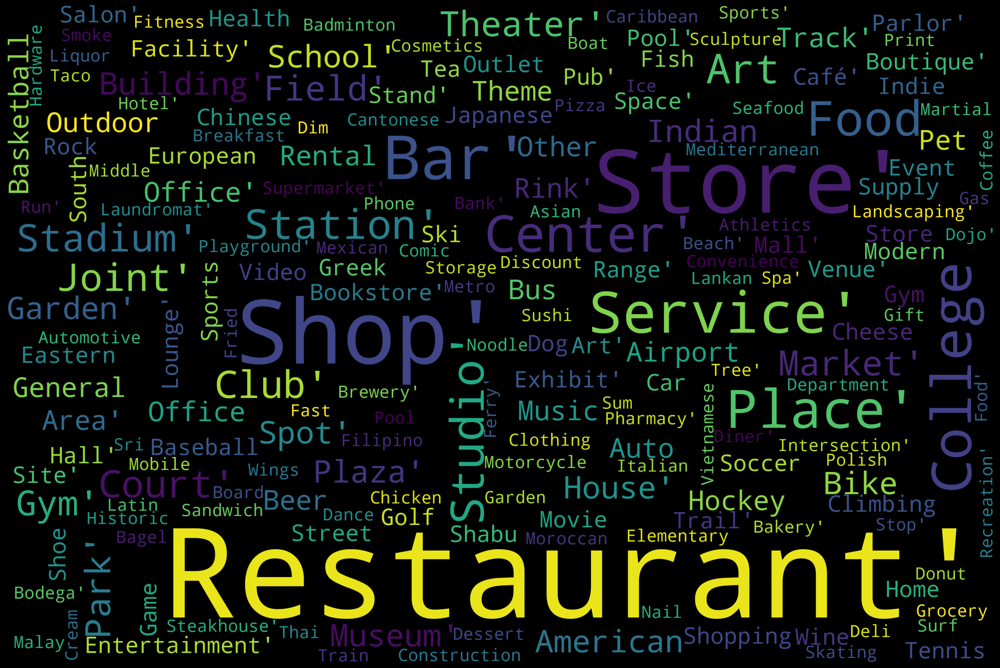

In [17]:
# common words in the category
text = popularity_df['Venue Category'].unique()
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(text))
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [54]:
# get the count of unique categories for each neighborhood
unique_categories = popularity_df.groupby('Neighborhood')['Venue Category'].nunique().to_frame().reset_index()
unique_categories.rename({'Venue Category': 'Count of Unique Venue Categories'}, inplace=True)
unique_categories

,Neighborhood,Venue Category
0,"Agincourt, Scarborough, Toronto",35
1,"Alderwood, Long Branch, Etobicoke, Toronto",22
2,"Allerton, Bronx, New York",40
3,"Annadale, Staten Island, New York",13
4,"Arden Heights, Staten Island, New York",19
5,"Arlington, Staten Island, New York",17
6,"Arrochar, Staten Island, New York",21
7,"Arverne, Queens, New York",27
8,"Astoria Heights, Queens, New York",52
9,"Astoria, Queens, New York",48


### Venue Category Bar Plot

Text(0.5, 0.98, 'Venue Category')

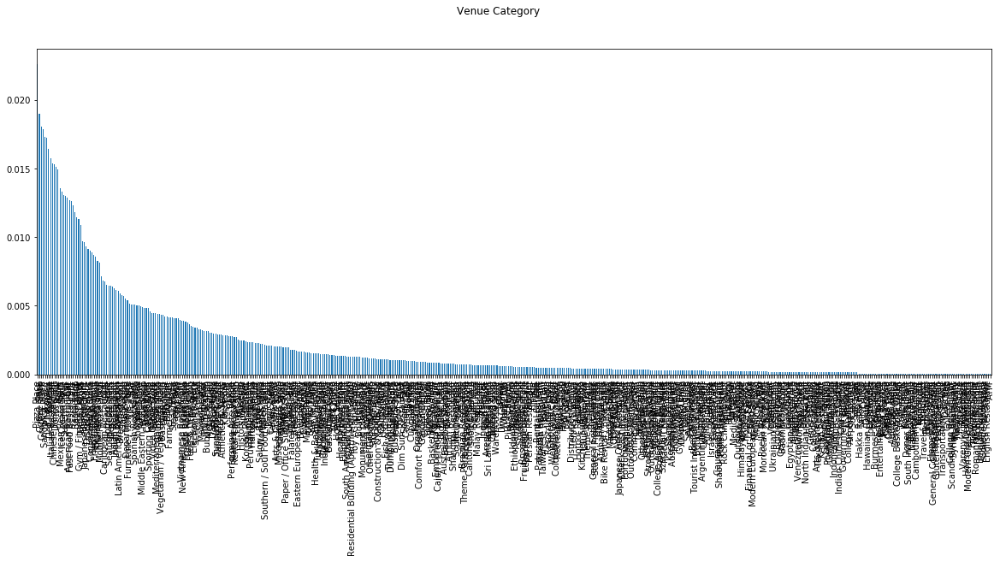

In [76]:
fig = plt.figure(figsize=(20,7))
popularity_df['Venue Category'].value_counts(normalize=True).plot(kind='bar')
fig.suptitle('Venue Category')

In [63]:
# Get the count of neighborhoods in which the category is available
cat_count = popularity_df.groupby(['Venue Category']).count()
cat_count = cat_count['Neighborhood'].reset_index()
cat_count.sort_values('Neighborhood', ascending=False, inplace=True)
cat_count.columns = ['category', 'nbh_count']
cat_count.reset_index(inplace=True, drop=True)
cat_count

,category,nbh_count
0,Pizza Place,350
1,Park,294
2,Coffee Shop,280
3,Grocery Store,277
4,Sandwich Place,268
5,Pharmacy,267
6,Bakery,255
7,Deli / Bodega,244
8,Italian Restaurant,238
9,Chinese Restaurant,237


## Data Cleaning

In [64]:
restaurants = cat_count[(cat_count.nbh_count<=50)&(cat_count.category.str.contains('Restaurant'))]
restaurants_lst = restaurants.category.tolist()
other_categories = set(cat_count.loc[cat_count.nbh_count<50,'category']) - set(restaurants_lst)

popular_nbhs = popularity_df.copy()
print("Count of unique categories before cleaning: ", len(popular_nbhs['Venue Category'].unique()))
popular_nbhs.loc[popular_nbhs['Venue Category'].isin(restaurants_lst+['Food Service']), 'Venue Category'] = 'Restaurant'
popular_nbhs.loc[popular_nbhs['Venue Category'].isin(['Botanical Garden']), 'Venue Category'] = 'Park' 
popular_nbhs = popular_nbhs[~popular_nbhs['Venue Category'].isin(other_categories)].copy()
print("Count of unique categories after cleaning: ", len(popular_nbhs['Venue Category'].unique()))

Count of unique categories before cleaning:  509
Count of unique categories after cleaning:  89


In [81]:
final_popular_nbhs = popular_nbhs.groupby(['Neighborhood', 'Venue Category']).max()
final_popular_nbhs.reset_index(inplace=True)
print(final_popular_nbhs.shape)
final_popular_nbhs.head()

(11059, 3)


,Neighborhood,Venue Category,Popularity Index
0,"Agincourt, Scarborough, Toronto",American Restaurant,5
1,"Agincourt, Scarborough, Toronto",Asian Restaurant,10
2,"Agincourt, Scarborough, Toronto",Bakery,42
3,"Agincourt, Scarborough, Toronto",Bank,32
4,"Agincourt, Scarborough, Toronto",Breakfast Spot,21


## Popularity Index Computation

In [77]:
# compute the popularity index
final_popular_nbhs['Popularity Index Rank'] = final_popular_nbhs.groupby(['Neighborhood'])['Popularity Index'].rank(pct=True)
popular_categories = final_popular_nbhs.drop(columns=['Popularity Index'])
popular_categories.rename(columns={'Popularity Index Rank': 'Popularity Index'}, inplace=True)
popular_categories[popular_categories.Neighborhood=='Agincourt, Scarborough, Toronto'].sort_values('Popularity Index', ascending=False)

,Neighborhood,Venue Category,Popularity Index
20,"Agincourt, Scarborough, Toronto",Shopping Mall,1.000000
21,"Agincourt, Scarborough, Toronto",Supermarket,0.958333
17,"Agincourt, Scarborough, Toronto",Restaurant,0.916667
6,"Agincourt, Scarborough, Toronto",Chinese Restaurant,0.875000
7,"Agincourt, Scarborough, Toronto",Coffee Shop,0.833333
2,"Agincourt, Scarborough, Toronto",Bakery,0.791667
5,"Agincourt, Scarborough, Toronto",Caribbean Restaurant,0.750000
22,"Agincourt, Scarborough, Toronto",Sushi Restaurant,0.708333
9,"Agincourt, Scarborough, Toronto",Indian Restaurant,0.666667
12,"Agincourt, Scarborough, Toronto",Lounge,0.625000


In [78]:
# list of unique categories
cat_lst = sorted(popular_categories['Venue Category'].unique().tolist())
print("Total No of Categories: ", len(cat_lst))
cat_lst

Total No of Categories:  89


['American Restaurant',
 'Asian Restaurant',
 'BBQ Joint',
 'Bagel Shop',
 'Bakery',
 'Bank',
 'Bar',
 'Baseball Field',
 'Bookstore',
 'Breakfast Spot',
 'Brewery',
 'Burger Joint',
 'Bus Station',
 'Bus Stop',
 'Café',
 'Caribbean Restaurant',
 'Chinese Restaurant',
 'Clothing Store',
 'Cocktail Bar',
 'Coffee Shop',
 'Convenience Store',
 'Cosmetics Shop',
 'Deli / Bodega',
 'Department Store',
 'Dessert Shop',
 'Diner',
 'Discount Store',
 'Dog Run',
 'Donut Shop',
 'Electronics Store',
 'Farmers Market',
 'Fast Food Restaurant',
 'Food & Drink Shop',
 'Food Truck',
 'French Restaurant',
 'Fried Chicken Joint',
 'Furniture / Home Store',
 'Gas Station',
 'Gastropub',
 'Gift Shop',
 'Gourmet Shop',
 'Greek Restaurant',
 'Grocery Store',
 'Gym',
 'Gym / Fitness Center',
 'Hotel',
 'Ice Cream Shop',
 'Indian Restaurant',
 'Intersection',
 'Italian Restaurant',
 'Japanese Restaurant',
 'Juice Bar',
 'Latin American Restaurant',
 'Liquor Store',
 'Lounge',
 'Mediterranean Restaurant',
 

## Final Df to be fed into the model

In [79]:
# The Final Df to be fed into the mode
popular_categories_wide = popular_categories.pivot(index='Neighborhood', columns='Venue Category', 
                                                   values='Popularity Index')
popular_categories_wide.fillna(0, inplace=True)
print(popular_categories_wide.shape)
popular_categories_wide.head()

(404, 89)


Venue Category,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Bookstore,Breakfast Spot,Brewery,Burger Joint,Bus Station,Bus Stop,Café,Caribbean Restaurant,Chinese Restaurant,Clothing Store,Cocktail Bar,Coffee Shop,Convenience Store,Cosmetics Shop,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dog Run,Donut Shop,Electronics Store,Farmers Market,Fast Food Restaurant,Food & Drink Shop,Food Truck,French Restaurant,Fried Chicken Joint,Furniture / Home Store,Gas Station,Gastropub,Gift Shop,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hotel,Ice Cream Shop,Indian Restaurant,Intersection,Italian Restaurant,Japanese Restaurant,Juice Bar,Latin American Restaurant,Liquor Store,Lounge,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Mobile Phone Shop,Movie Theater,New American Restaurant,Park,Pet Store,Pharmacy,Pizza Place,Playground,Plaza,Pub,Restaurant,Salad Place,Sandwich Place,Scenic Lookout,Seafood Restaurant,Shopping Mall,Spa,Spanish Restaurant,Sporting Goods Shop,Steakhouse,Supermarket,Sushi Restaurant,Taco Place,Thai Restaurant,Theater,Trail,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Shop,Yoga Studio
Neighborhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"Agincourt, Scarborough, Toronto",0.166667,0.25,0.0,0.000000,0.791667,0.583333,0.00,0.0,0.0,0.333333,0.0000,0.0,0.00000,0.000000,0.0,0.7500,0.87500,0.00000,0.0,0.833333,0.000000,0.000,0.0000,0.541667,0.00000,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.00000,0.0,0.0,0.0,0.000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.00000,0.666667,0.000000,0.000000,0.416667,0.0,0.458333,0.000000,0.625,0.041667,0.000000,0.0,0.000,0.0,0.0,0.083333,0.0,0.208333,0.500000,0.0000,0.0,0.000000,0.916667,0.0,0.291667,0.0,0.37500,1.000000,0.000000,0.0,0.0,0.0,0.958333,0.708333,0.0,0.0,0.0,0.000000,0.0,0.0,0.125,0.0,0.0
"Alderwood, Long Branch, Etobicoke, Toronto",0.000000,0.00,0.0,0.000000,0.000000,0.000000,0.00,0.0,0.0,0.000000,0.0000,0.0,0.00000,0.000000,0.0,0.0000,0.00000,0.00000,0.0,0.470588,0.294118,0.000,0.0000,0.000000,0.00000,0.00,0.882353,0.000000,0.352941,0.0,0.0,0.00000,0.0,0.0,0.0,0.000,0.0,0.705882,0.0,0.000000,0.0,0.0,0.941176,0.764706,0.0,0.0,0.00000,0.000000,0.411765,0.000000,0.000000,0.0,0.000000,0.235294,0.000,0.000000,0.000000,0.0,0.000,0.0,0.0,0.823529,0.0,0.647059,0.588235,0.0000,0.0,0.529412,0.176471,0.0,0.117647,0.0,0.00000,1.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.058824,0.0,0.0,0.000,0.0,0.0
"Allerton, Bronx, New York",0.343750,0.00,0.0,0.000000,0.093750,0.625000,0.25,0.0,0.0,0.656250,0.6875,0.0,0.03125,0.000000,0.0,0.4375,0.46875,0.21875,0.0,0.000000,0.281250,0.125,0.1875,0.000000,0.71875,0.75,0.312500,0.000000,0.812500,0.0,0.0,0.96875,0.0,0.0,0.0,0.875,0.0,0.531250,0.0,0.000000,0.0,0.0,0.156250,0.000000,0.0,0.0,0.59375,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.000000,0.843750,0.0,0.375,0.0,0.0,0.000000,0.0,0.937500,0.781250,0.5625,0.0,0.000000,0.000000,0.0,0.500000,0.0,0.40625,0.000000,0.062500,0.0,0.0,0.0,1.000000,0.000000,0.0,0.0,0.0,0.906250,0.0,0.0,0.000,0.0,0.0
"Annadale, Staten Island, New York",0.100000,0.00,0.0,0.000000,0.700000,0.000000,0.00,0.0,0.0,0.000000,0.0000,0.0,0.00000,0.400000,0.0,0.0000,0.00000,0.00000,0.0,0.000000,0.000000,0.500,0.2000,0.000000,0.00000,0.60,0.000000,0.000000,0.000000,0.0,0.0,0.00000,0.0,0.0,0.0,0.000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.000000,0.000000,0.0,0.000,0.0,0.0,0.000000,0.0,0.300000,0.800000,0.0000,0.0,0.000000,1.000000,0.0,0.000000,0.0,0.00000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.900000,0.0,0.0,0.000,0.0,0.0
"Arden Heights, Staten Island, New York",0.000000,0.00,0.0,0.411765,0.000000,0.823529,0.00,0.0,0.0,0.000000,0.0000,0.0,0.00000,0.235294,0.0,0.0000,0.00000,0.00000,0.0,0.3